<a href="https://colab.research.google.com/github/Prdazk/collabku/blob/main/Train_YOLOv12_Object_Detection_Model_Complete.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**How to Train YOLOv12 Object Detection Model on a Custom Dataset**

In [8]:
!nvidia-smi

Thu Oct 16 02:24:16 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   37C    P8              9W /   70W |       2MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

**Step 01 # Install the Ultralytics Package**

In [9]:
!pip install ultralytics

**Step 02 # Import All the Requried Libraries**

In [6]:
import os
import ultralytics
ultralytics.checks()

Ultralytics 8.3.214 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 39.9/112.6 GB disk)


In [10]:
from ultralytics import YOLO
from IPython.display import Image

In [11]:
HOME = os.getcwd()
print(HOME)

/content


**Step # 03 Download Dataset from Roboflow**

https://universe.roboflow.com/project-uyrxf/ppe_detection-v1x3l/dataset/2

In [12]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="hzoVrDHDbdeFNRLoh2Nq")
project = rf.workspace("project-uyrxf").project("ppe_detection-v1x3l")
version = project.version(2)
dataset = version.download("yolov12")

loading Roboflow workspace...
loading Roboflow project...


In [13]:
!ls {dataset.location}

data.yaml  README.dataset.txt  README.roboflow.txt  test  train  valid


**Step # 04 Fine-tune YOLOv12 model on a Custom Dataset**

**NOTE:** We need to make a few changes to our downloaded dataset so it will work with YOLOv12. Run the following bash commands to prepare your dataset for training by updating the relative paths in the `data.yaml` file, ensuring it correctly points to the subdirectories for your dataset's `train`, `test`, and `valid` subsets.

In [14]:
!sed -i '$d' {dataset.location}/data.yaml
!sed -i '$d' {dataset.location}/data.yaml
!sed -i '$d' {dataset.location}/data.yaml
!sed -i '$d' {dataset.location}/data.yaml
!echo -e "test: ../test/images\ntrain: ../train/images\nval: ../valid/images" >> {dataset.location}/data.yaml

In [15]:
!cat {dataset.location}/data.yaml

train: ../train/images
val: ../valid/images
test: ../test/images

nc: 7
names: ['Dust Mask', 'Eye Wear', 'Glove', 'Protective Boots', 'Protective Helmet', 'Safety Vest', 'Shield']

roboflow:
  workspace: project-uyrxf
test: ../test/images
train: ../train/images
val: ../valid/images


We are now ready to fine-tune our YOLOv12 model. In the code below, we initialize the model using a starting checkpoint—here, we use `yolov12s.yaml`, but you can replace it with any other model (e.g., `yolov12n.pt`, `yolov12m.pt`, `yolov12l.pt`, or `yolov12x.pt`) based on your preference. We set the training to run for 50 epochs in this example; however, you should adjust the number of epochs along with other hyperparameters such as batch size, image size, and augmentation settings (scale, mosaic, mixup, and copy-paste) based on your hardware capabilities and dataset size.

**Note:** **Note that after training, you might encounter a `TypeError: argument of type 'PosixPath' is not iterable error` — this is a known issue, but your model weights will still be saved, so you can safely proceed to running inference.**

In [16]:
model = YOLO("yolo12s.yaml")

In [17]:
results = model.train(data=f'{dataset.location}/data.yaml', epochs=50)

Ultralytics 8.3.214 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/PPE_Detection-2/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo12s.yaml, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True

**Step # 05 Evaluate fine-tuned YOLOv12 model**


In [22]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

!ls {HOME}/runs/detect/train3/

ls: cannot access '/content/runs/detect/train3/': No such file or directory


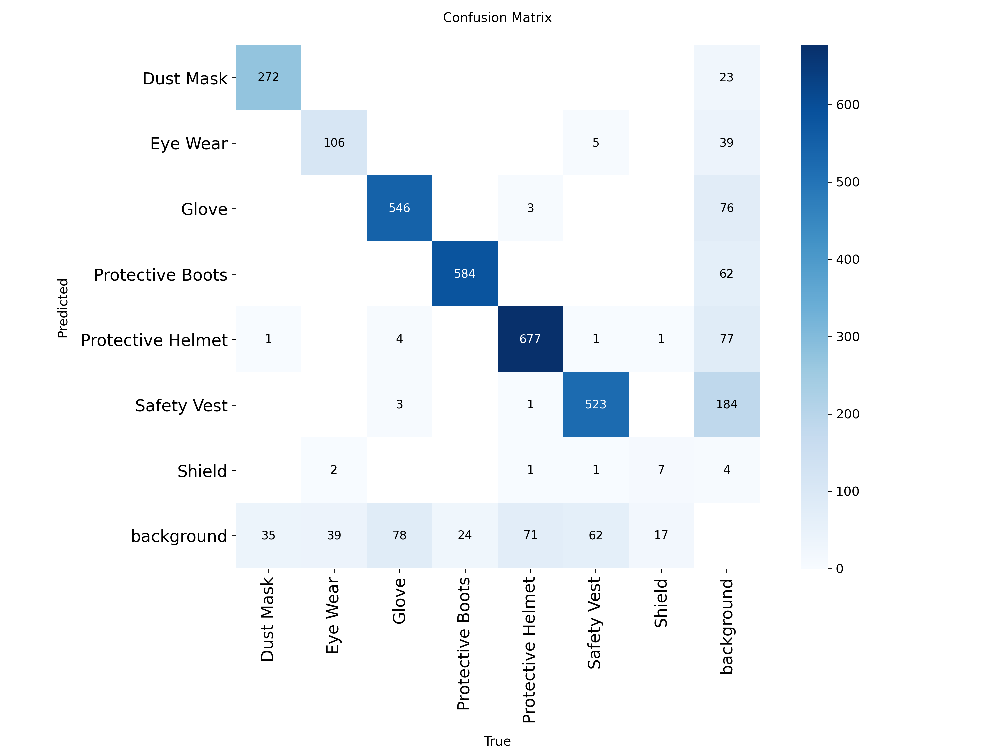

In [25]:
from IPython.display import Image

Image(filename='/content/runs/detect/train/confusion_matrix.png', width=1000)


Precision = TP / (TP + FP)

Precision is simply true positives out of total detections.


In [31]:
from ultralytics import YOLO

# Load model terbaik
model = YOLO('/content/runs/detect/train/weights/best.pt')

# Jalankan evaluasi di data validasi (akan membuat semua grafik evaluasi)
model.val()


Ultralytics 8.3.214 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1360.3±431.9 MB/s, size: 68.1 KB)
val: Scanning /content/PPE_Detection-2/valid/labels.cache... 637 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 637/637 861.6Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 40/40 2.9it/s 13.7s
                   all        637       3064      0.876      0.764      0.819      0.535
             Dust Mask        299        308      0.942      0.867      0.917      0.613
              Eye Wear        146        147      0.794       0.68      0.744      0.413
                 Glove        346        631      0.899      0.854      0.896      0.592
      Protective Boots        298        608      0.916      0.949      0.968      0.666
     Protective Helmet        403  

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b384a84ac90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
  

Recall = TP / (TP + FN)

Recall is the True Positive out of all Ground Truths

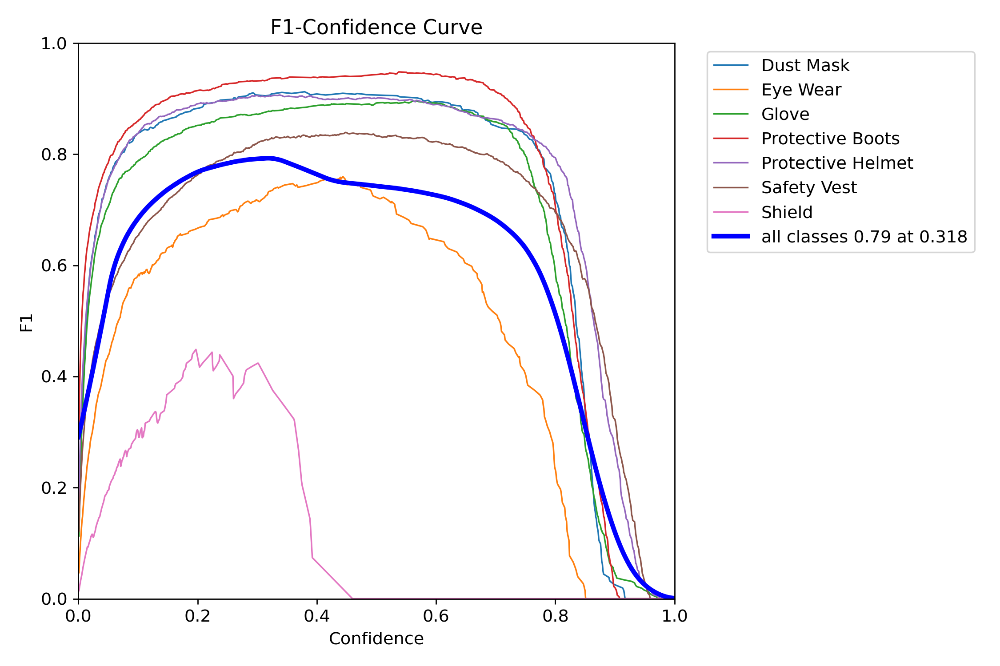

In [33]:
from IPython.display import Image

Image(filename='/content/runs/detect/train/BoxF1_curve.png', width=1000)


In [34]:
!ls -R /content


Streaming output truncated to the last 5000 lines.
image_257_jpg.rf.2d42007064ac5bdab7c99e79d98589f6.jpg
image_257_jpg.rf.c13fa4d4f4b56c5cf7d4606c7dc08e76.jpg
image_258_jpg.rf.a79ffbcac1fe69918d084e648ca34c68.jpg
image_258_jpg.rf.da1d36f5b0af77a6fc557a758ff53060.jpg
image_259_jpg.rf.773dc9fc8e6d4622ebafec09a5c98c59.jpg
image_25_jpg.rf.0a6c793473668ae14959a381fd46c2f0.jpg
image_25_jpg.rf.515a3d4b9ce463f2c05e9c97200a42fa.jpg
image_25_jpg.rf.7f5141078a04e64b3d8156977ac6081a.jpg
image_25_jpg.rf.a0995fae0b481cf639b2c14a2d1529f2.jpg
image_25_jpg.rf.d4b306b8860f3ddf23446f027ff77cd3.jpg
image_261_jpg.rf.71d9c48694ff15d50424cdd19517e85a.jpg
image_261_jpg.rf.d15bee079106554b96a644721151d84f.jpg
image_264_jpg.rf.92a4c9b28af9198cf126b470210891ae.jpg
image_264_jpg.rf.a3a8540b2a9292028bf3b7f23ab5712b.jpg
image_266_jpg.rf.92c0ef7e47aba85490152d5bf7ce6500.jpg
image_266_jpg.rf.b369871828171fd54ee05b2fe7604346.jpg
image_26_jpg.rf.acb30ce8da7528ce1b0980749f4f4ee8.jpg
image_26_jpg.rf.b4251e7b8f6264e6a350d

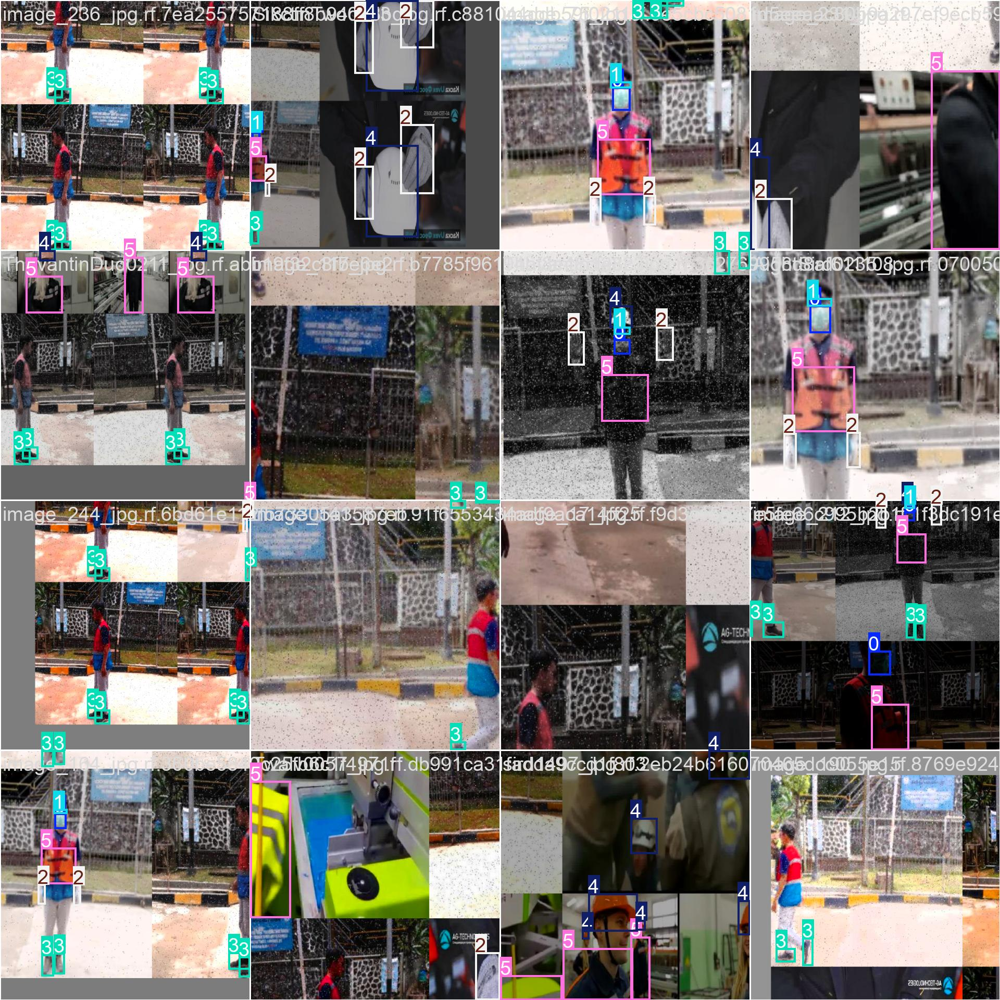

In [36]:
from IPython.display import Image
Image(filename='/content/runs/detect/train/train_batch0.jpg', width=1000)


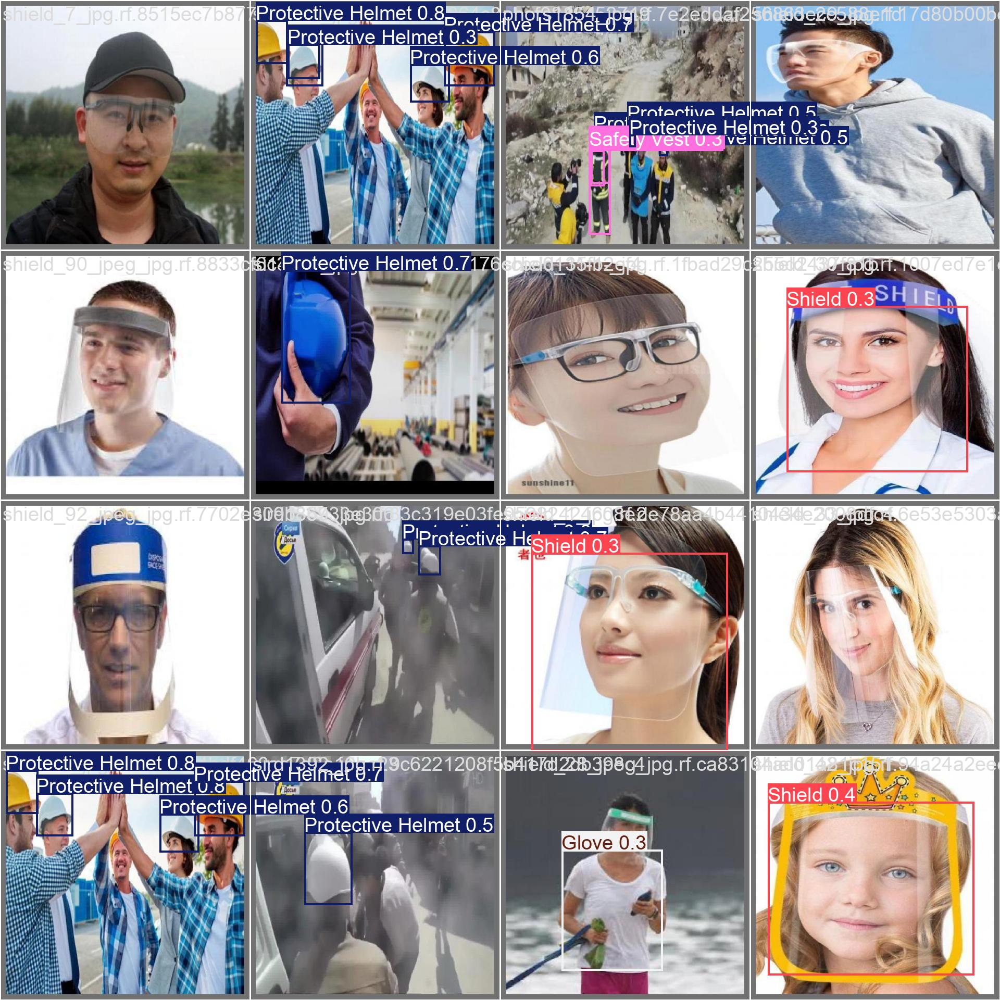

In [ ]:
Image(filename=f'{HOME}/runs/detect/train3/val_batch0_pred.jpg', width=1000)

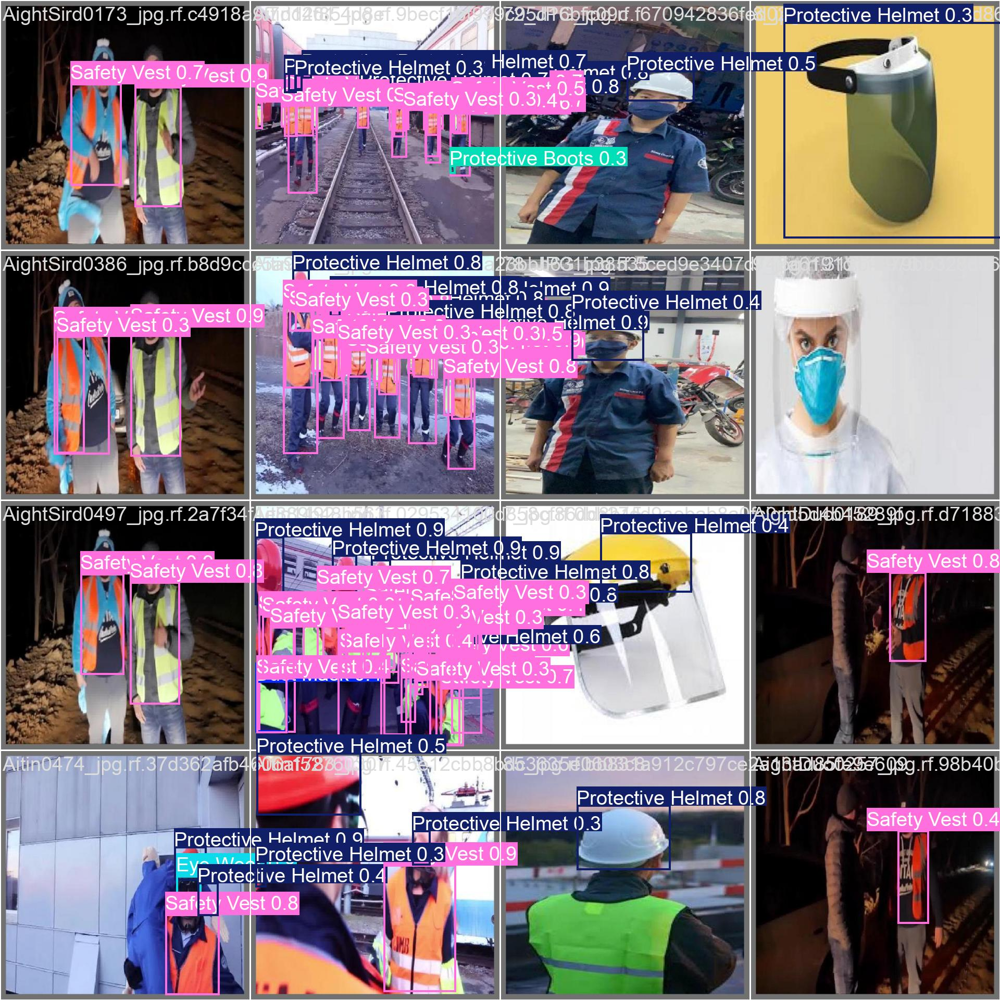

In [38]:
from IPython.display import Image
Image(filename='/content/runs/detect/train/val_batch1_pred.jpg', width=1000)


**Step # 06 Download the Model Weights from the Google Drive**

In [39]:
!gdown "https://drive.google.com/uc?id=1ka7Gj8RE6iP8-ExtigZJhmiyr5k5lqRQ&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1ka7Gj8RE6iP8-ExtigZJhmiyr5k5lqRQ&confirm=t
To: /content/best.pt
100% 18.9M/18.9M [00:00<00:00, 31.6MB/s]


**Step # 07  Validate Fine-Tuned Model**

In [40]:
model = YOLO("best.pt")  # load a custom model

# Validate the model
metrics = model.val()  # no arguments needed, dataset and settings remembered
metrics.box.map  # map50-95
metrics.box.map50  # map50
metrics.box.map75  # map75
metrics.box.maps  # a list contains map50-95 of each category

Ultralytics 8.3.214 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1062.2±386.8 MB/s, size: 37.7 KB)
val: Scanning /content/PPE_Detection-2/valid/labels.cache... 637 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 637/637 426.5Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 40/40 2.7it/s 14.8s
                   all        637       3064      0.855      0.735      0.796      0.518
             Dust Mask        299        308      0.943      0.834      0.896      0.594
              Eye Wear        146        147       0.71      0.667      0.706      0.375
                 Glove        346        631      0.882      0.853      0.893      0.579
      Protective Boots        298        608      0.865      0.956      0.972      0.666
     Protective Helmet        403  

array([    0.59415,     0.37467,     0.57911,     0.66556,     0.65227,     0.59312,     0.16788])

**Step # 08 Inference with Custom Model on Images**

In [41]:
dataset.location

'/content/PPE_Detection-2'

In [42]:
results = model.predict(source = f"{dataset.location}/test/images", save = True)


image 1/322 /content/PPE_Detection-2/test/images/000446_jpg.rf.63a960737ed4b762294eea1ad1a92791.jpg: 640x640 3 Protective Helmets, 20.9ms
image 2/322 /content/PPE_Detection-2/test/images/20220721_161946_jpg.rf.905c375aa964159f9edab2a55a6e7476.jpg: 640x640 1 Protective Helmet, 21.0ms
image 3/322 /content/PPE_Detection-2/test/images/20220721_162015_jpg.rf.ccb5d8a5aed0bb50c04431fa0b0d5479.jpg: 640x640 1 Protective Helmet, 20.9ms
image 4/322 /content/PPE_Detection-2/test/images/20220721_162036_jpg.rf.2664c2f59604cd2380a51fd174055a7e.jpg: 640x640 1 Protective Helmet, 20.9ms
image 5/322 /content/PPE_Detection-2/test/images/20220721_162308_jpg.rf.913971a6c64f38eabc6b69bab4409b46.jpg: 640x640 (no detections), 20.9ms
image 6/322 /content/PPE_Detection-2/test/images/20220721_162435_jpg.rf.d478427044384d4e32ba0c25b15b720d.jpg: 640x640 (no detections), 21.0ms
image 7/322 /content/PPE_Detection-2/test/images/20220721_162444_jpg.rf.107652f17f526c25f74bb7b181c46717.jpg: 640x640 1 Protective Helmet, 

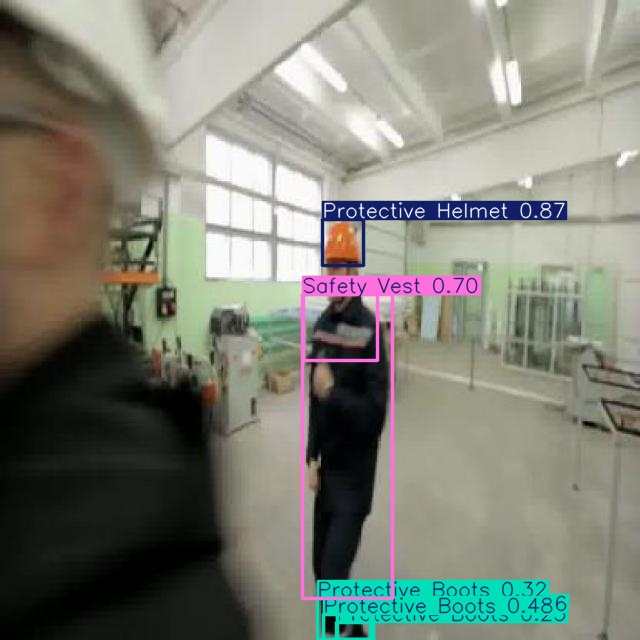

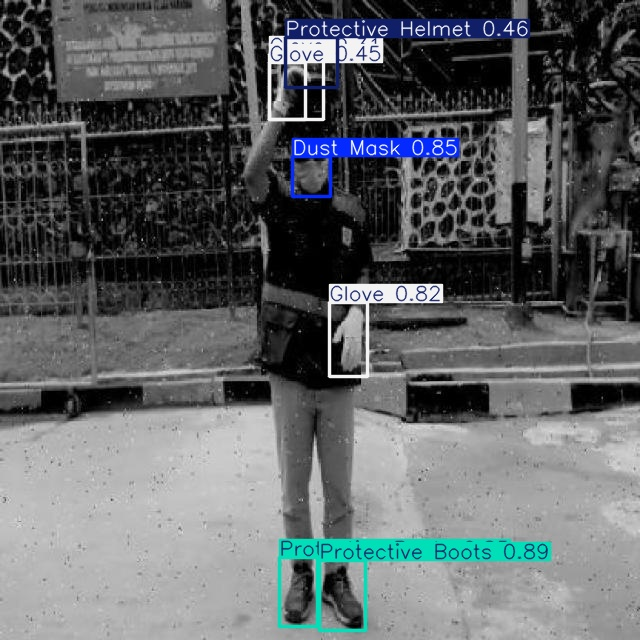

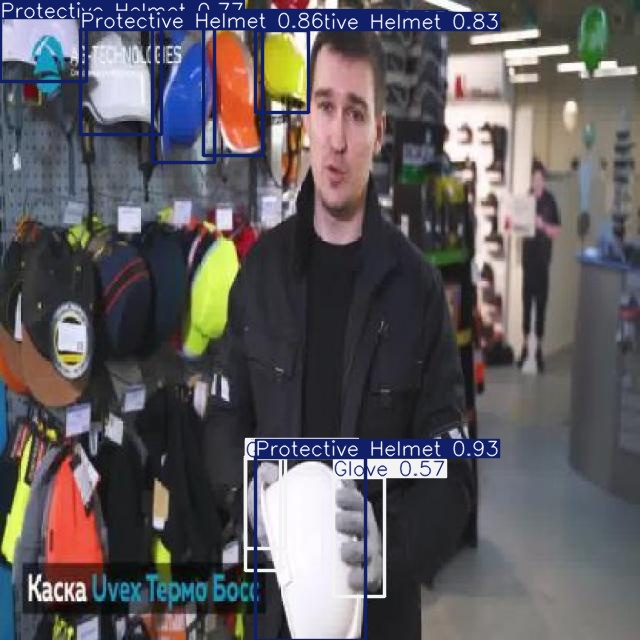

In [43]:
import glob
import os
from IPython.display import Image as IPyImage, display

latest_folder = max(glob.glob(f'{HOME}/runs/detect/predict*/'), key=os.path.getmtime)
for img in glob.glob(f'{latest_folder}/*.jpg')[2:5]:
    display(IPyImage(filename=img, width=600))
    print("\n")

**Step # 09 Inference with Custom Model on Videos**

In [44]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [45]:
!gdown "https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t
To: /content/PPE_Part1.mp4
100% 14.2M/14.2M [00:00<00:00, 35.9MB/s]


In [46]:
!gdown "https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t
To: /content/PPE_Part2.mp4
100% 11.1M/11.1M [00:00<00:00, 53.8MB/s]


In [47]:
results = model.predict(source = f"/{HOME}/PPE_Part1.mp4", save = True)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/310) //content/PPE_Part1.mp4: 384x640 (no detections), 73.8ms
video 1/1 (frame 2/310) //content/PPE_Part1.mp4: 384x640 1 Safety Vest, 31.4ms
video 1/1 (frame 3/310) //content/PPE_Part1.mp4: 384x640 (no detections), 15.3ms
video 1/1 (frame 4/310) //content/PPE_Part1.mp4: 384x640 (no detections), 19.1ms
video 1/1 (frame 5/310) //content/PPE_Part1.mp4: 384x640 (no detections), 18.5ms
video 1/1 (frame 6/310) //content/PPE_Part1.mp4: 384x

In [48]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [49]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = f'{HOME}/runs/detect/predict/PPE_Part1.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [50]:
results = model.predict(source = f"/{HOME}/PPE_Part2.mp4", save = True)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/267) //content/PPE_Part2.mp4: 384x640 (no detections), 16.0ms
video 1/1 (frame 2/267) //content/PPE_Part2.mp4: 384x640 (no detections), 15.4ms
video 1/1 (frame 3/267) //content/PPE_Part2.mp4: 384x640 (no detections), 19.7ms
video 1/1 (frame 4/267) //content/PPE_Part2.mp4: 384x640 (no detections), 19.3ms
video 1/1 (frame 5/267) //content/PPE_Part2.mp4: 384x640 (no detections), 22.1ms
video 1/1 (frame 6/267) //content/PPE_Part2.mp4: 38

In [51]:
!rm '/content/result_compressed.mp4'

In [52]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = f'{HOME}/runs/detect/predict/PPE_Part2.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)